***Importing necessary libraries***

In [36]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
from itertools import combinations
from collections import Counter
import plotly.express as px
import folium
from folium.plugins import MarkerCluster
from sklearn.cluster import DBSCAN

***Loading dataset***

In [2]:
df=pd.read_csv(r"C:\Users\lenovo\Downloads\Dataset .csv")
df

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Ma...",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",...,Botswana Pula(P),Yes,No,No,No,4,4.4,Green,Very Good,270
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, O...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056475,14.585318,"Japanese, Sushi",...,Botswana Pula(P),No,No,No,No,4,4.9,Dark Green,Excellent,365
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.057508,14.584450,"Japanese, Korean",...,Botswana Pula(P),Yes,No,No,No,4,4.8,Dark Green,Excellent,229
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,5915730,Naml۱ Gurme,208,��stanbul,"Kemanke�� Karamustafa Pa��a Mahallesi, R۱ht۱m ...",Karak�_y,"Karak�_y, ��stanbul",28.977392,41.022793,Turkish,...,Turkish Lira(TL),No,No,No,No,3,4.1,Green,Very Good,788
9547,5908749,Ceviz A��ac۱,208,��stanbul,"Ko��uyolu Mahallesi, Muhittin ��st�_nda�� Cadd...",Ko��uyolu,"Ko��uyolu, ��stanbul",29.041297,41.009847,"World Cuisine, Patisserie, Cafe",...,Turkish Lira(TL),No,No,No,No,3,4.2,Green,Very Good,1034
9548,5915807,Huqqa,208,��stanbul,"Kuru�_e��me Mahallesi, Muallim Naci Caddesi, N...",Kuru�_e��me,"Kuru�_e��me, ��stanbul",29.034640,41.055817,"Italian, World Cuisine",...,Turkish Lira(TL),No,No,No,No,4,3.7,Yellow,Good,661
9549,5916112,A���k Kahve,208,��stanbul,"Kuru�_e��me Mahallesi, Muallim Naci Caddesi, N...",Kuru�_e��me,"Kuru�_e��me, ��stanbul",29.036019,41.057979,Restaurant Cafe,...,Turkish Lira(TL),No,No,No,No,4,4.0,Green,Very Good,901


In [3]:
#Displaying info given in dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9551 entries, 0 to 9550
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Restaurant ID         9551 non-null   int64  
 1   Restaurant Name       9551 non-null   object 
 2   Country Code          9551 non-null   int64  
 3   City                  9551 non-null   object 
 4   Address               9551 non-null   object 
 5   Locality              9551 non-null   object 
 6   Locality Verbose      9551 non-null   object 
 7   Longitude             9551 non-null   float64
 8   Latitude              9551 non-null   float64
 9   Cuisines              9542 non-null   object 
 10  Average Cost for two  9551 non-null   int64  
 11  Currency              9551 non-null   object 
 12  Has Table booking     9551 non-null   object 
 13  Has Online delivery   9551 non-null   object 
 14  Is delivering now     9551 non-null   object 
 15  Switch to order menu 

In [4]:
#Statistical data
df.describe()

,Restaurant ID,Country Code,Longitude,Latitude,Average Cost for two,Price range,Aggregate rating,Votes
count,9.551000e+03,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000
mean,9.051128e+06,18.365616,64.126574,25.854381,1199.210763,1.804837,2.666370,156.909748
std,8.791521e+06,56.750546,41.467058,11.007935,16121.183073,0.905609,1.516378,430.169145
min,5.300000e+01,1.000000,-157.948486,-41.330428,0.000000,1.000000,0.000000,0.000000
25%,3.019625e+05,1.000000,77.081343,28.478713,250.000000,1.000000,2.500000,5.000000
50%,6.004089e+06,1.000000,77.191964,28.570469,400.000000,2.000000,3.200000,31.000000
75%,1.835229e+07,1.000000,77.282006,28.642758,700.000000,2.000000,3.700000,131.000000
max,1.850065e+07,216.000000,174.832089,55.976980,800000.000000,4.000000,4.900000,10934.000000


In [5]:
#Count missing values
df.isnull().sum()

Restaurant ID           0
Restaurant Name         0
Country Code            0
City                    0
Address                 0
Locality                0
Locality Verbose        0
Longitude               0
Latitude                0
Cuisines                9
Average Cost for two    0
Currency                0
Has Table booking       0
Has Online delivery     0
Is delivering now       0
Switch to order menu    0
Price range             0
Aggregate rating        0
Rating color            0
Rating text             0
Votes                   0
dtype: int64

***Data Cleaning***

In [6]:
fill_cuisines = df['Cuisines'].fillna('Unknown', inplace=True)

***LEVEL 1***

**Task 1 - Top Cuisines**

*Determine top three most common cuisines in the dataset.*

In [7]:
#Count occurence of each cuisine
cuisine_counts= df['Cuisines'].str.split(', ').explode().value_counts()

#Top 3 most common cuisines
new_df=cuisine_counts.head(3)

print("The top three most common cuisines are: ")
print(new_df)

The top three most common cuisines are: 
Cuisines
North Indian    3960
Chinese         2735
Fast Food       1986
Name: count, dtype: int64


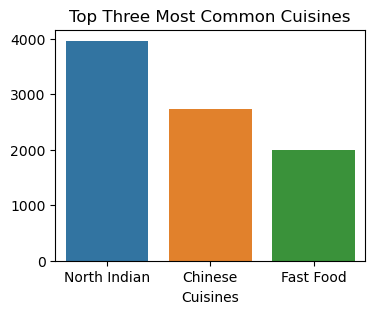

In [8]:
plt.figure(figsize=(4,3), dpi=100)
sns.barplot(x=new_df.index, y=new_df.values)
plt.title("Top Three Most Common Cuisines")
plt.show()

*Calculate the percentage of restaurants that serve each of the top cuisinese*s.

In [9]:
total_restaurants = len(df)
cuisine_percentage=(cuisine_counts/total_restaurants)*100

print("Percentage of restaurants serving each cuisine is: ")
new_df_percentage = cuisine_percentage.head()
print(new_df_percentage)

Percentage of restaurants serving each cuisine is: 
Cuisines
North Indian    41.461627
Chinese         28.635745
Fast Food       20.793634
Mughlai         10.417757
Italian          7.999162
Name: count, dtype: float64


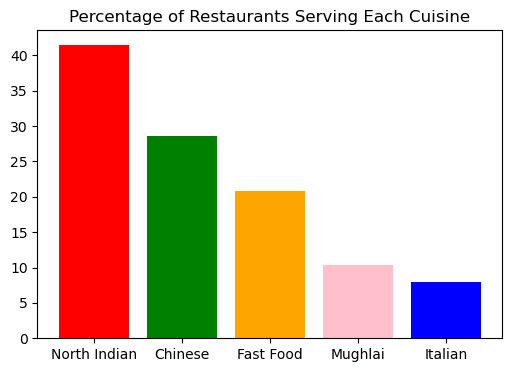

In [10]:
plt.figure(figsize=(6,4), dpi=100)

colors=['red', 'green', 'orange', 'pink', 'blue']

plt.bar(new_df_percentage.index, new_df_percentage.values, color=colors)

plt.title("Percentage of Restaurants Serving Each Cuisine")
plt.show()

**Task 2 - City Analysis**

*Identify the city with the highest number of restaurants in the dataset.*

In [11]:
city = df.groupby('City')['Restaurant ID'].count().sort_values(ascending=False)
city.head(1)

City
New Delhi    5473
Name: Restaurant ID, dtype: int64

*Calculate the average rating for restaurants in each city.*

In [12]:
avg_rating = df.groupby('City')['Aggregate rating'].mean()
avg_rating

City
Abu Dhabi          4.300000
Agra               3.965000
Ahmedabad          4.161905
Albany             3.555000
Allahabad          3.395000
                     ...   
Weirton            3.900000
Wellington City    4.250000
Winchester Bay     3.200000
Yorkton            3.300000
��stanbul          4.292857
Name: Aggregate rating, Length: 141, dtype: float64

*Determine the city with the highest average rating.*

In [13]:
avg_rating = df.groupby('City')['Aggregate rating'].mean()
avg_rating.head(1)

City
Abu Dhabi    4.3
Name: Aggregate rating, dtype: float64

**Task 3 - Price Range Distribution**

*Create a histogram or bar chart to visualize the distribution of price ranges visualize the distribution of price ranges among the restaurants.*

In [14]:
count_price_range=df['Price range'].value_counts
count_price_range

<bound method IndexOpsMixin.value_counts of 0       3
1       3
2       4
3       4
4       4
       ..
9546    3
9547    3
9548    4
9549    4
9550    2
Name: Price range, Length: 9551, dtype: int64>

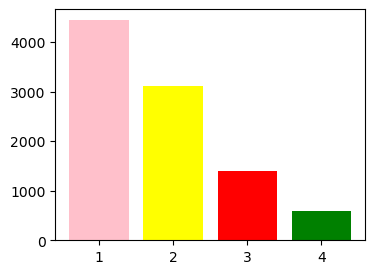

In [15]:
plt.figure(figsize=(4,3))

colors=['pink', 'yellow', 'red', 'green']

result = count_price_range()  # Call the function
plt.bar(result.index, result.values, color=colors)

plt.show()

*Calculate the percentage of restaurants in each price range category.*

In [16]:
percentage_price_range = (df['Price range'].value_counts()/len(df))*100
percentage_price_range

Price range
1    46.529159
2    32.593446
3    14.741912
4     6.135483
Name: count, dtype: float64

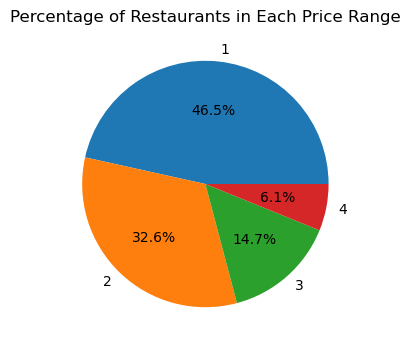

In [17]:
labels=[1,2,3,4]

plt.figure(figsize=(4,4))

plt.pie(percentage_price_range, labels=labels, autopct='%1.1f%%')    

plt.title("Percentage of Restaurants in Each Price Range")

plt.show()       

**Task 4 - Online Delivery**

*Determine the percentage of restaurants that offer online delivery.**

In [18]:
yes = df[df['Has Online delivery']== 'Yes']

count_online_delivery = len(yes)
count_online_delivery_percentage = (count_online_delivery/len(df)*100)

print(count_online_delivery_percentage)

25.662234321013504


*Compare the average ratings of restaurants with and without online delivery.*

In [19]:
compare_avg_rating = df.groupby('Has Online delivery')['Aggregate rating'].mean()
compare_avg_rating

Has Online delivery
No     2.465296
Yes    3.248837
Name: Aggregate rating, dtype: float64

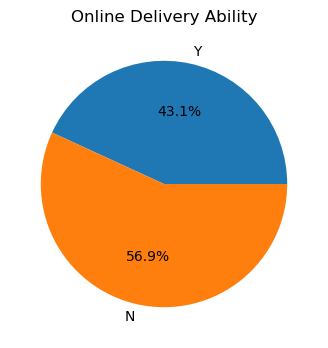

In [20]:
labels=['Y', 'N']
plt.figure(figsize=(4,4))

plt.pie(compare_avg_rating, labels=labels, autopct='%1.1f%%')    

plt.title("Online Delivery Ability")

plt.show()   

***LEVEL 2***

**Task 1 - Restaurant Ratings**

*Analyze the distribution of aggregate ratings and determine the most common rating range.**

In [21]:
#Analyze the distribution of aggregate ratings
print(df["Aggregate rating"].describe())

count    9551.000000
mean        2.666370
std         1.516378
min         0.000000
25%         2.500000
50%         3.200000
75%         3.700000
max         4.900000
Name: Aggregate rating, dtype: float64


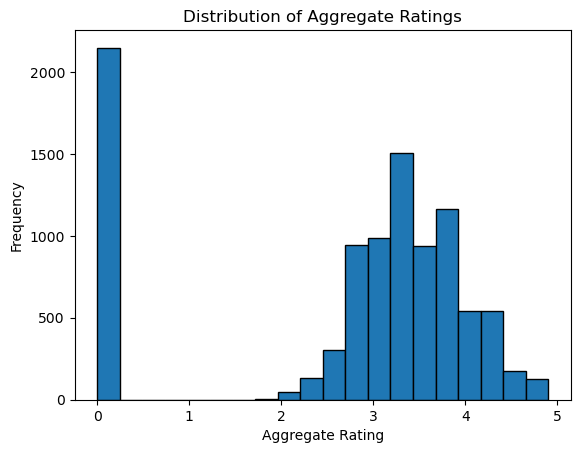

In [22]:
plt.hist(df["Aggregate rating"], bins=20, edgecolor="black")

plt.xlabel("Aggregate Rating")
plt.ylabel("Frequency")

plt.title("Distribution of Aggregate Ratings")
plt.show()

In [23]:
#Determine the most common rating range
rating_bins = [0, 1, 2, 3, 4, 5]
rating_labels = ["0-1", "1-2", "2-3", "3-4", "4-5"]
df["Rating Range"] = pd.cut(df["Aggregate rating"], bins=rating_bins, labels=rating_labels)
print(df["Rating Range"].value_counts())

Rating Range
3-4    4388
2-3    1891
4-5    1114
1-2      10
0-1       0
Name: count, dtype: int64


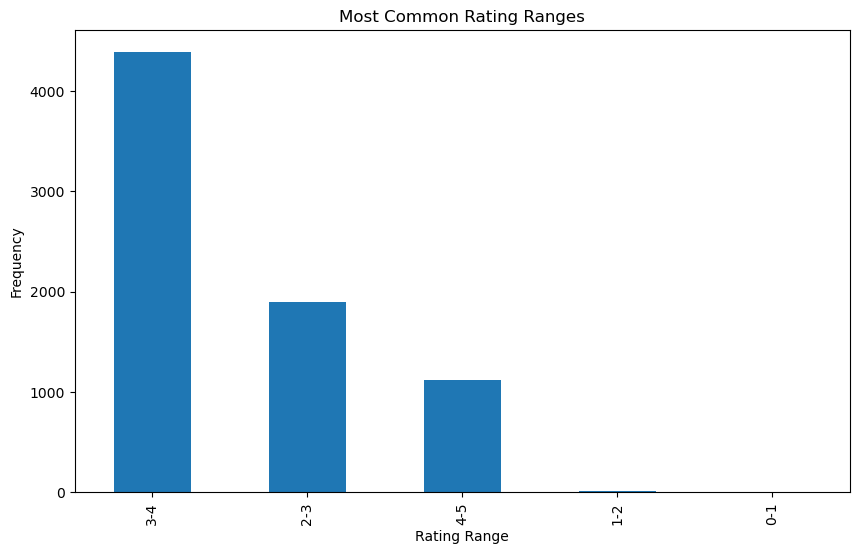

In [24]:
#Bar chart of rating ranges
plt.figure(figsize=(10, 6))

df["Rating Range"].value_counts().plot(kind="bar")

plt.xlabel("Rating Range")
plt.ylabel("Frequency")

plt.title("Most Common Rating Ranges")
plt.show()

*Calculate the average number of votes received by restaurants.*

In [25]:
avg_votes = df["Votes"].mean()

print(df["Votes"].describe())

In [26]:
print("Average number of votes is: ", avg_votes)

Average number of votes is:  156.909747670401


**Task 2 - Cuisine Combination**

*Identify the most common combinations of cuisines in the dataset.*

In [64]:
#Extract the cuisine column
cuisines = df["Cuisines"].str.split(",").tolist()

In [65]:
#Create a list of cuisine combinations
cuisine_combinations = []
for cuisine_list in cuisines:
    cuisine_list = [cuisine.strip() for cuisine in cuisine_list]
    for r in range(1, len(cuisine_list) + 1):
        cuisine_combinations.extend(combinations(cuisine_list, r))

In [66]:
#Count the frequency of each cuisine combination
cuisine_combination_counts = Counter(cuisine_combinations)

In [67]:
#Print the most common cuisine combinations
for combination, count in cuisine_combination_counts.most_common(10):
    print(f"{combination}: {count}")

('North Indian',): 3960
('Chinese',): 2735
('Fast Food',): 1986
('North Indian', 'Chinese'): 1516
('Mughlai',): 995
('Italian',): 764
('Bakery',): 745
('Continental',): 736
('North Indian', 'Mughlai'): 728
('Cafe',): 703


*Determine if certain cuisine combinations tend to have higher ratings.*

In [68]:
#Extract the cuisine and rating columns
cuisines = df["Cuisines"].str.split(",").tolist()
ratings = df["Aggregate rating"].tolist()

In [74]:
#Create a list of cuisine combinations and corresponding ratings
cuisine_combinations = []
ratings_combinations = []

for r in range(1, len(cuisine_list) + 1):
    for combo in combinations(cuisine_list, r):
        combination = tuple(sorted(combo))
        cuisine_combinations.append(combination)
        ratings_combinations.append(ratings[])

SyntaxError: invalid syntax. Perhaps you forgot a comma? (1416104017.py, line 9)

In [70]:
#Create a dictionary to store the average rating for each cuisine combination
cuisine_combination_ratings = {}
for combination, rating in zip(cuisine_combinations, ratings_combinations):
    if combination not in cuisine_combination_ratings:
        cuisine_combination_ratings[combination] = []
    cuisine_combination_ratings[combination].append(rating)

In [71]:
#Calculate the average rating for each cuisine combination
for combination, ratings in cuisine_combination_ratings.items():
    cuisine_combination_ratings[combination] = np.mean(ratings)

In [72]:
#Print the top 10 cuisine combinations with the highest average ratings
for combination, rating in sorted(cuisine_combination_ratings.items(), key=lambda x: x[1], reverse=True)[:10]:
    print(f"{combination}: {rating:.2f}")

**Task 3 - Geographic Analysis**

*Plot the locations of restaurants on a map using longitude and latitude coordinates..*

In [41]:
#Check for null values in 'Longitude' and 'Latitude' columns
df[['Longitude', 'Latitude']].isnull().sum()

Longitude    0
Latitude     0
dtype: int64

In [42]:
#Create a base map
map = folium.Map(location=[df['Latitude'].mean(), df['Longitude'].mean()], zoom_start=12)

In [43]:
#Add points to the map

marker_cluster = MarkerCluster().add_to(map)
for idx, row in df.iterrows():
    folium.Marker(
        location=[row['Latitude'], row['Longitude']],
        popup=f"Rating: {row['Aggregate rating']}"
    ).add_to(marker_cluster)

In [44]:
map.save('restaurants_map.html')

In [46]:
map

*Identify any patterns or clusters of restaurants in specific areas.*

In [47]:
#Prepare the data for clustering
cord = df[['Latitude', 'Longitude']].values

In [48]:
#Run DBSCAN clustering
DB = DBSCAN(eps=0.01, min_samples=5, metric='haversine').fit(np.radians(cord))
labels = DB.labels_

In [49]:
#Add cluster labels to the DataFrame
df['Cluster'] = labels

In [50]:
#Print the number of clusters found
numbers_of_clusters = len(set(labels)) - (1 if -1 in labels else 0)
numbers_of_clusters

78

In [51]:
#Plot clusters on the map
map = folium.Map(location=[df['Latitude'].mean(), df['Longitude'].mean()], zoom_start=12)
colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray']
for idx, row in df.iterrows():
    folium.Marker(
        location=[row['Latitude'], row['Longitude']],
        popup=f"Rating: {row['Aggregate rating']}",
        icon=folium.Icon(color=colors[row['Cluster'] % len(colors)])
    ).add_to(map)

In [52]:
#Save the map to an HTML file
map.save('restaurants_clusters_map.html')

In [53]:
map

**Task 4 - Restaurant Chains**

*Identify if there are any restaurant chains present in the dataset.*

*Analyze the ratings and popularity of different restaurant chains.**

In [54]:
chain_count=df["Restaurant Name"].value_counts()
chain_count

Restaurant Name
Cafe Coffee Day             83
Domino's Pizza              79
Subway                      63
Green Chick Chop            51
McDonald's                  48
                            ..
Odeon Social                 1
Johnny Rockets               1
House of Commons             1
HotMess                      1
Walter's Coffee Roastery     1
Name: count, Length: 7446, dtype: int64

In [55]:
chain=chain_count[chain_count>1].index
chain

Index(['Cafe Coffee Day', 'Domino's Pizza', 'Subway', 'Green Chick Chop',
       'McDonald's', 'Keventers', 'Pizza Hut', 'Giani', 'Baskin Robbins',
       'Barbeque Nation',
       ...
       'Raasta', 'The Pint Room', 'Snacks Point', 'The Dosa King', 'Chokola',
       'Town Hall', 'Halki Aanch', 'Snack Junction', 'Delhi Biryani Hut',
       'Beliram Degchiwala'],
      dtype='object', name='Restaurant Name', length=734)

In [57]:
chain_restaurants=df[df["Restaurant Name"].isin(chain)]
chain_restaurants

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes,Rating Range,Cluster
5,18189371,Din Tai Fung,162,Mandaluyong City,"Ground Floor, Mega Fashion Hall, SM Megamall, ...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056314,14.583764,Chinese,...,No,No,No,3,4.4,Green,Very Good,336,4-5,0
10,6309903,Silantro Fil-Mex,162,Pasig City,"75 East Capitol Drive, Kapitolyo, Pasig City",Kapitolyo,"Kapitolyo, Pasig City",121.057916,14.567689,"Filipino, Mexican",...,No,No,No,3,4.9,Dark Green,Excellent,1070,4-5,0
12,6318433,Silantro Fil-Mex,162,Quezon City,"Second Floor, UP Town Center, Katipunan Avenue...","UP Town Center, Diliman, Quezon City","UP Town Center, Diliman, Quezon City, Quezon City",121.075419,14.649503,"Filipino, Mexican",...,No,No,No,3,4.8,Dark Green,Excellent,294,4-5,0
35,6601589,Coco Bambu,30,Bras�_lia,"Bras�_lia Shopping - Piso 2, SCN 5, Bloco A, A...","Bras�_lia Shopping, Asa Norte","Bras�_lia Shopping, Asa Norte, Bras�_lia",-47.889000,-15.786500,International,...,No,No,No,4,4.2,Green,Very Good,17,4-5,1
39,6600427,Coco Bambu,30,Bras�_lia,"SCES, Trecho 2, Conjunto 13/36, Setor de Clube...",Setor De Clubes Esportivos Sul,"Setor De Clubes Esportivos Sul, Bras�_lia",-47.868500,-15.819000,International,...,No,No,No,4,4.9,Dark Green,Excellent,30,4-5,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9517,6001980,Timboo Cafe,208,Ankara,"Armada AVM, Kat -1, Eski��ehir Yolu, No 6, Yen...","Armada AVM, S�_���_t�_z�_, Yenimahalle","Armada AVM, S�_���_t�_z�_, Yenimahalle, Ankara",32.809247,39.913206,Cafe,...,No,No,No,3,4.2,Green,Very Good,134,4-5,76
9528,6003668,Timboo Cafe,208,Ankara,"Kentpark AVM, Kat -1, Mustafa Kemal Mahallesi,...","Kentpark AVM, ��niversiteler, �ankaya","Kentpark AVM, ��niversiteler, �ankaya, Ankara",32.776255,39.908957,Cafe,...,No,No,No,3,4.2,Green,Very Good,79,4-5,76
9534,6004089,D�_vero��lu,208,Ankara,"Maltepe Mahallesi, Gen�_lik Caddesi, No 28, �a...",Maltepe,"Maltepe, Ankara",32.842742,39.922536,"Kebab, Desserts, Turkish Pizza",...,No,No,No,3,4.4,Green,Very Good,131,4-5,76
9535,6000921,D�_vero��lu,208,Ankara,"��mitk�_y Mahallesi, 2432. Cadde (8. Cadde), N...",��mitk�_y,"��mitk�_y, Ankara",32.701775,39.891564,"Kebab, Desserts, Turkish Pizza",...,No,No,No,3,4.2,Green,Very Good,152,4-5,76


In [59]:
chain_avg_rating = chain_restaurants.groupby('Restaurant Name')['Aggregate rating'].mean().sort_values(ascending=False)
chain_avg_rating

Restaurant Name
Talaga Sampireun                   4.900
Silantro Fil-Mex                   4.850
AB's Absolute Barbecues            4.850
AB's - Absolute Barbecues          4.825
Naturals Ice Cream                 4.800
                                   ...  
Big Biryani                        0.000
Flavours Kitchen                   0.000
Anand Sweets                       0.000
Radha Swami Shudh Vaishno Dhaba    0.000
OCD - Online Cake Delivery         0.000
Name: Aggregate rating, Length: 734, dtype: float64

In [61]:
chain_popularity = chain_restaurants.groupby('Restaurant Name')['Votes'].sum().sort_values(ascending=False)
chain_popularity

Restaurant Name
Barbeque Nation              28142
AB's - Absolute Barbecues    13400
Big Chill                    10853
Farzi Cafe                   10098
Truffles                      9682
                             ...  
Bikaner Misthan Bhandar          0
Aap Ki Khatir                    0
Street Cafe                      0
Jyoti Sweets                     0
Firangi Bake                     0
Name: Votes, Length: 734, dtype: int64

In [62]:
chain_analysis = pd.DataFrame({
    'average_rating': chain_avg_rating,
    'total_reviews': chain_popularity
}).sort_values(by='average_rating', ascending=False)

In [63]:
chain_analysis

,average_rating,total_reviews
Restaurant Name,,
Talaga Sampireun,4.900,5514
Silantro Fil-Mex,4.850,1364
AB's Absolute Barbecues,4.850,3151
AB's - Absolute Barbecues,4.825,13400
Naturals Ice Cream,4.800,3094
...,...,...
Big Biryani,0.000,1
Flavours Kitchen,0.000,3
Anand Sweets,0.000,3
